In [1]:
import matplotlib.pyplot as plt
import numpy as np
import plotly.express as px
import pandas as pd
import seaborn as sns
from scipy.spatial import ConvexHull
import geojson
import numpy as np
import geopandas
import geodatasets
import wordcloud as wc
from PIL import Image
import folium
import altair as alt
from vega_datasets import data

C:\Users\seamu\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


In [2]:
LISTINGS = 'listings.csv'
NUMBERS = ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9']

In [3]:
listings = pd.read_csv(LISTINGS)
listings.head()

,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,3781,https://www.airbnb.com/rooms/3781,20231218233145,2023-12-19,city scrape,Rental unit in Boston · ★4.96 · 1 bedroom · 1 ...,NaN,"Mostly quiet ( no loud music, no crowed sidewa...",https://a0.muscache.com/pictures/24670/b2de044...,4804,...,4.96,4.88,4.92,NaN,f,1,1,0,0,0.23
1,5506,https://www.airbnb.com/rooms/5506,20231218233145,2023-12-19,city scrape,Guest suite in Boston · ★4.79 · 1 bedroom · 1 ...,NaN,"Peaceful, Architecturally interesting, histori...",https://a0.muscache.com/pictures/miso/Hosting-...,8229,...,4.89,4.55,4.75,STR-490093,f,10,10,0,0,0.68
2,6695,https://www.airbnb.com/rooms/6695,20231218233145,2023-12-19,city scrape,Condo in Boston · ★4.81 · Studio · 2 beds · 1 ...,NaN,"Peaceful, Architecturally interesting, histori...",https://a0.muscache.com/pictures/38ac4797-e7a4...,8229,...,4.95,4.51,4.71,STR-491702,f,10,10,0,0,0.73
3,8789,https://www.airbnb.com/rooms/8789,20231218233145,2023-12-19,city scrape,Rental unit in Boston · ★4.67 · 1 bedroom · 1 ...,NaN,Beacon Hill is a historic neighborhood filled ...,https://a0.muscache.com/pictures/miso/Hosting-...,26988,...,4.96,4.96,4.56,NaN,f,9,9,0,0,0.24
4,10813,https://www.airbnb.com/rooms/10813,20231218233145,2023-12-19,city scrape,Rental unit in Boston · ★5.0 · Studio · 1 bed ...,NaN,Wander around this quintessential neighborhood...,https://a0.muscache.com/pictures/20b5b9c9-e1f4...,38997,...,5.00,5.00,4.80,NaN,f,11,11,0,0,0.09


In [4]:
listings['bathrooms'] = listings['bathrooms_text'].apply(lambda x: x.split(" ")[0] if type(x) == str else 0)
listings['bathrooms'] = listings['bathrooms'].apply(lambda x: float(x) if str(x)[0] in NUMBERS else np.nan)
listings['bathrooms'] = listings['bathrooms'].dropna()

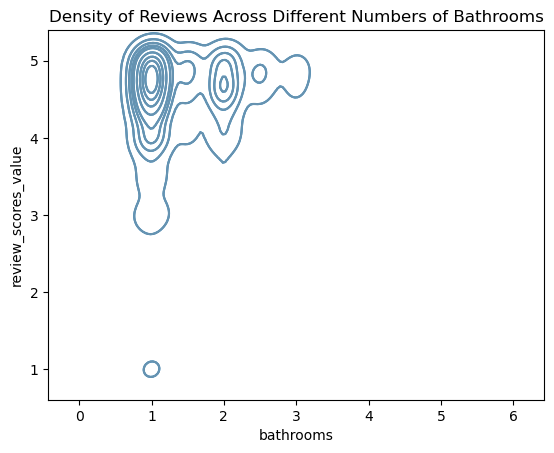

In [22]:
sns.kdeplot(data = listings, x='bathrooms', y='review_scores_value')
plot = sns.kdeplot(data = listings, x='bathrooms', y='review_scores_value', 
                   color ="#6793b0").set(title="Density of Reviews Across Different Numbers of Bathrooms")

fig = plot[0].get_figure()
fig.savefig('images/bathrooms.png')

In [17]:
boston = geopandas.read_file("Boston_Neighborhood_Boundaries_approximated_by_2020_Census_Block_Groups/Boston_Neighborhood_Boundaries_approximated_by_2020_Census_Block_Groups.shp")
boston_neighborhoods = boston[["blockgr202", "geometry"]]
neighborhood_agg = listings.groupby("neighbourhood_cleansed", as_index=False)["review_scores_value"].mean()
geometry = pd.merge(boston, neighborhood_agg, left_on = "blockgr202", right_on = "neighbourhood_cleansed")

In [18]:
review = geometry.explore(column = "review_scores_value", legend=True, name="Boston AirBnB Reviews", 
                          
                          
                          
                          
                          tooltip=['review_scores_value', 'neighbourhood_cleansed'], popup=['review_scores_value', 'neighbourhood_cleansed'])
map_title = "Average Reviews Across All Neighborhoods"
title_html = f'<h5 style="position:absolute;z-index:100000;left:6vw" >{map_title}</h5>'
review.get_root().html.add_child(folium.Element(title_html))
review.save("review-by-neighborhoood.html")
review

In [21]:
#scatterplot where user selects the attributes to compare
#want to add binning to let people choose by neighborhood?

columns = ['review_scores_communication','review_scores_location', 'calculated_host_listings_count', 'calculated_host_listings_count_entire_homes', 'calculated_host_listings_count_private_rooms', 'calculated_host_listings_count_shared_rooms','reviews_per_month']

select_box = alt.binding_select(options=columns, name='column')
sel = alt.selection_single(fields=['column'], bind=select_box, value='review_scores_communication')

chart = alt.Chart(listings, title="Average Review Value's Effect on Review Characteristics").transform_fold(
    columns,
    as_ = ['column', 'value']
).transform_filter(
    sel
).mark_point(color = '#6793b0').encode(
    x='review_scores_value:Q',
    y='value:Q',
).add_selection(
sel
)
chart.save('scatterplot.html')
chart

alt.Chart(...)

In [9]:
fig = px.box(listings, x="neighbourhood_cleansed", y="review_scores_value", title="Comparative Box Plot of AirB&B Ratings Across Neighborhoods",
            )
fig.update_layout(xaxis_title="Neighborhood", yaxis_title="Rating")
fig.update_layout({
"plot_bgcolor": "white",
   
})
fig.update_xaxes(tickangle=270)
fig.update_xaxes(
    mirror=True,
    ticks='outside',
    showline=True,
    linecolor='black',
)
fig.update_yaxes(
    mirror=True,
    ticks='outside',
    showline=True,
    linecolor='black',
)

fig.update_traces(marker_color = '#6793b0', marker_line_color = '#666',
                  marker_line_width = 2, opacity = 1)


fig.show()
fig.write_html('boxplot.html')

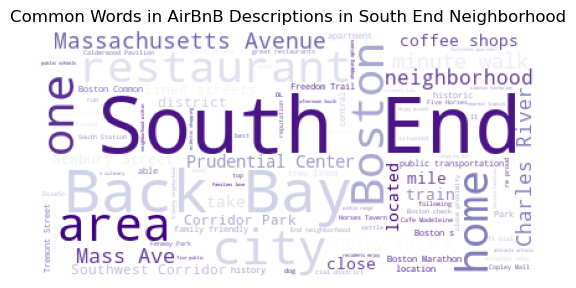

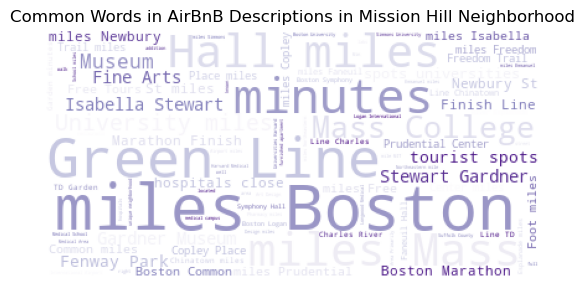

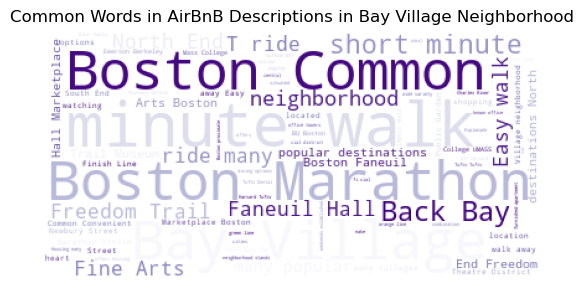

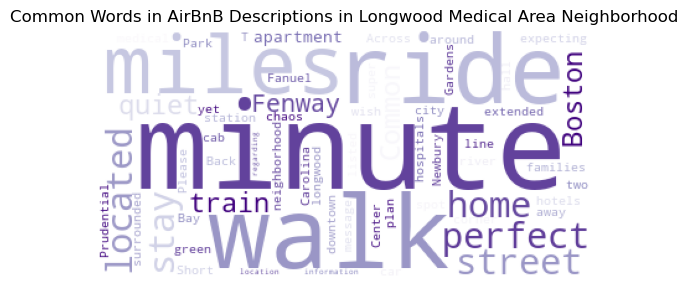

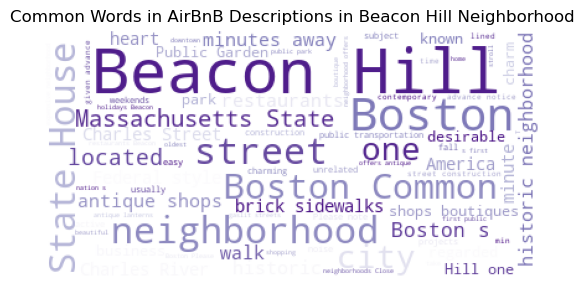

...

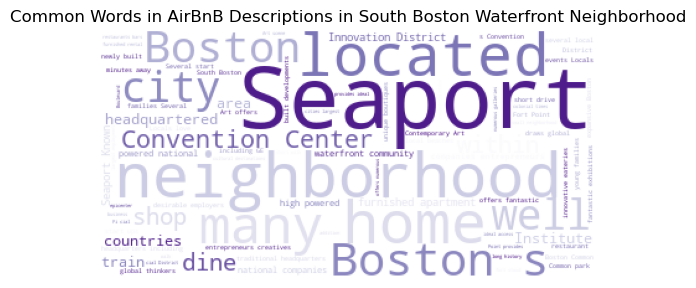

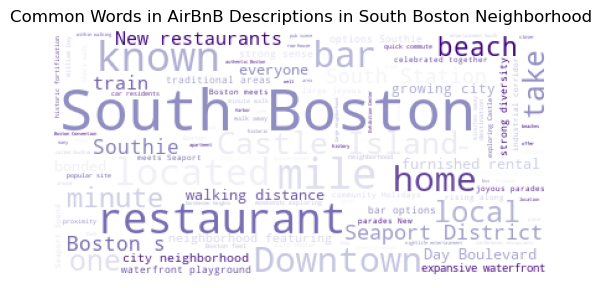

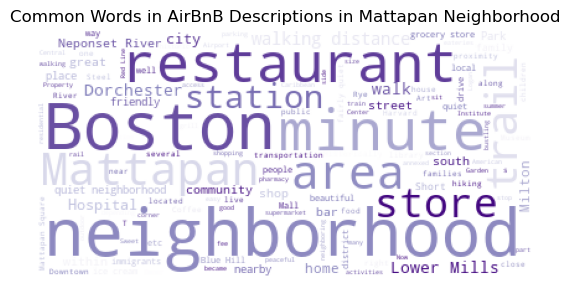

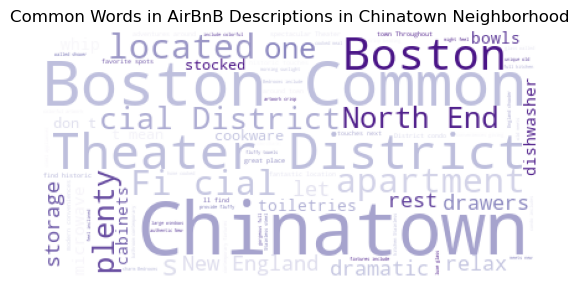

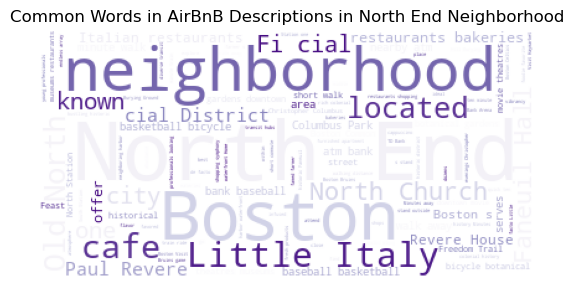

In [10]:
words = " ".join([str(description).replace("<br />", " ").replace("nan", " ") for description in list(listings["neighborhood_overview"]) 
])
unique_neighborhoods = list(set(listings["neighbourhood_cleansed"]))

for n in unique_neighborhoods:
    n_listings = listings[listings["neighbourhood_cleansed"] == n]
    words = " ".join([str(description).replace("<br />", " ").replace("nan", " ")
                      for description in list(n_listings["neighborhood_overview"])
    ])
    cloud = wc.WordCloud(background_color="white", colormap="Purples")
    listings_cloud = cloud.generate(words)
    plt.axis('off')
    plt.title(f'Common Words in AirBnB Descriptions in {n} Neighborhood')
    plt.imshow(listings_cloud)
    plt.show()